In [1]:
import matplotlib.pyplot as plt
import random
import numpy as np

import pandas as pd
from matplotlib.ticker import LogFormatter 
from scipy.optimize import curve_fit
from pathlib import Path
import matplotlib.colors
from matplotlib import ticker, cm
import pickle
from scipy.stats import norm
import matplotlib.animation as animation

In [38]:
def plot_figura(posX, posY, N, dt,tempo):
    figname = 'f.jpeg'
    plt.figure(figsize=(5,3))
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.ylim(-1.05, 1.05)
    plt.title('ФПУ-симуляция '.format(tempo/dt))

    x = []
    y = []

    tamanho_step_pra_mostrar_N = 1                 
    for i in range(0, len(posX), tamanho_step_pra_mostrar_N):
        x.append(posX[i])
        y.append(posY[i])

    plt.scatter(x, y, c='r', s=5)
    plt.grid()
    plt.savefig(figname)            
    plt.close()
    images.append(imageio.imread(figname))
    os.remove(figname)

In [39]:
def acceleration(posY,alpha,k,massa):
    size = len(posY)

    aceY = [0.0 for i in range(size)]
    for i in range(1,size-1):
        aceY[i] = (k/massa) * ((posY[i+1] + posY[i-1] - 2*posY[i]) * ( 1.0 + alpha*(posY[i+1]-posY[i-1]) ) )
    
    aceY[0] = (k/massa) * ((posY[1] + posY[-1] - 2*posY[0]) * ( 1.0 + alpha*(posY[1]-posY[-1]) ) )
    aceY[-1] = (k/massa) * ((posY[0] + posY[-2] - 2*posY[-1]) * ( 1.0 + alpha*(posY[0]-posY[-2]) ) )

    return aceY

In [40]:

dt = 0.3

def velocity(posY,veloY,alpha,k,massa,dt=dt):
    size = len(posY)
    aceY = acceleration(posY,alpha,k,massa)
    new_veloY = [0.0 for i in range(size)]
    for i in range(0,size):
        new_veloY[i] = veloY[i] + aceY[i]*dt

    return new_veloY

In [41]:
def pos(posY, new_veloY, dt):
    size = len(posY)

    new_posY = [0.0 for i in range(size)]
    for i in range(size):
    #for i in range(1,size-1):
        new_posY[i] = posY[i] + new_veloY[i]*dt

    return new_posY

In [42]:
def veloc_final_(veloY, aceY, dt):
    size = len(veloY)

    new_veloY = [0.0 for i in range(size)]
    #for i in range(1,size-1):
    for i in range(size):
        new_veloY[i] = veloY[i] + aceY[i]*dt

    return new_veloY

In [43]:
def mode_energy(x, x_old, n_particles, L, dt):
     
    tmp = np.arange(0, n_particles, 1)
    tmp[-1:] = 0
    m = np.sqrt(2.0 / (n_particles)) * np.dot(x, np.sin( ( 2 * tmp * L * np.pi / (n_particles) ) ))
    m_old = np.sqrt(2.0 / (n_particles)) * np.dot(x_old, np.sin( ( 2 * tmp * L * np.pi / (n_particles) ) ))
    #return 0.5 * (m - m_old)**2 + 0.5 * (m + m_old)**2 * np.sin( np.pi * L / (2 * (n_particles)) )**2
    return 0.5 * (m - m_old)**2 / dt**2 + (0.5 * (m + m_old)**2 * np.sin( np.pi * L / (2 * (n_particles)) )**2)
        

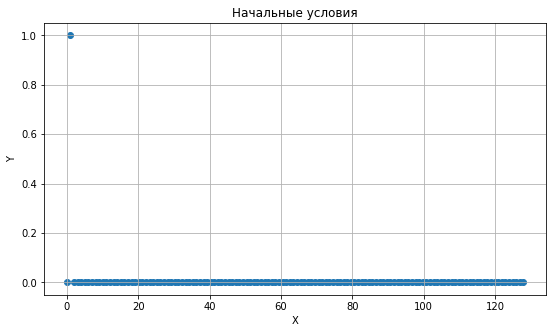

In [71]:

N = 64*2
periodo = 1       
pi = np.pi
massa = 1.0
k = 1.0
alpha = 0
beta = 0.0
init_mode = 1
lamb = 2/init_mode

dt = 0.3
step = dt
intervalo_imagem = 3



const_init  = 1 
posX = np.linspace(0,N,N)
posY = np.zeros_like(posX)  #состояние покоя 
posY[1] = const_init 
posY[-1:] = 0
veloY = [0.0 for i in range(N)]
 
plt.figure(figsize=(9,5))
plt.ylabel("Y")
plt.xlabel("X")
plt.title("Начальные условия")
#plt.plot(posX, posY,alpha=0.4)
plt.scatter(posX, posY)
plt.grid()
plt.show()
plt.close()

In [72]:
import imageio
import os
from IPython.display import Image

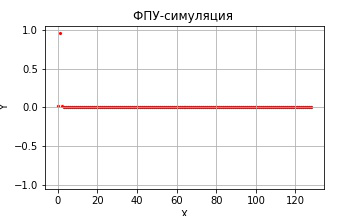

In [73]:
veloY = [0.0 for i in range(N)]

images = []
figname = 'f.jpeg'

posY_old = posY.copy()
energia1 = []
energia2 = []
energia3 = []
energia4 = []

t = 0
dt=0.01
tempo = 2000*dt
contador_fig = 0
while(t < tempo):
  
    if(contador_fig == intervalo_imagem):
        plot_figura(posX,posY,N,dt,tempo)

        contador_fig = 0
 
    new_veloY = velocity(posY,veloY,alpha,k,massa)

    posY = pos(posY, new_veloY, dt)

    new_aceY = acceleration(posY,alpha,k,massa)

    veloY = veloc_final_(new_veloY, new_aceY,dt)
 
    energia1.append( mode_energy(posY, posY_old, N, 0.5, dt) )  
    energia2.append( mode_energy(posY, posY_old, N, 1, dt) )
    energia3.append( mode_energy(posY, posY_old, N, 1.5, dt) )
    energia4.append( mode_energy(posY, posY_old, N, 2, dt) )
    
    posY_old = posY.copy()
    
    t = t + dt
    contador_fig = contador_fig + 1

np.fft.fft(energia1)     
np.fft.fft(energia2)
np.fft.fft(energia3)
np.fft.fft(energia4)

plt.close()
imageio.mimsave('a.gif', images,fps=30)
Image(open('a.gif','rb').read())

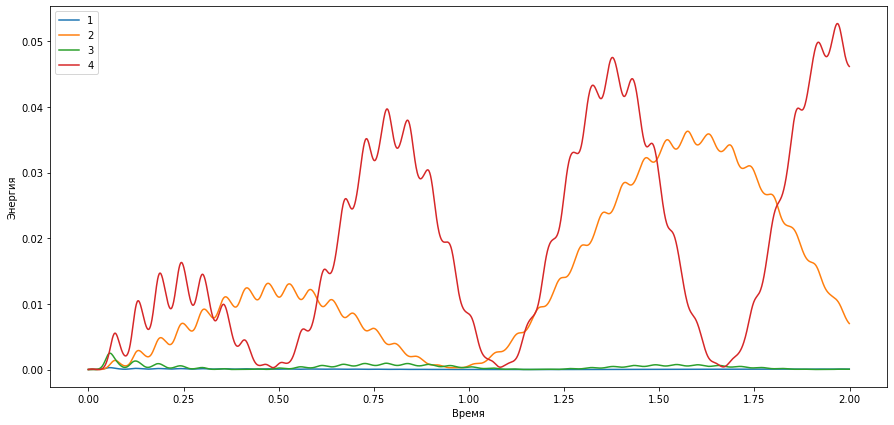

In [70]:
plt.figure(figsize=(15,7))
plt.title('')
plt.xlabel("Время")
plt.ylabel("Энергия")
plt.plot(np.arange(len(energia1))/1000, energia1,label="1")
plt.plot(np.arange(len(energia1))/1000,energia2,label="2")
plt.plot(np.arange(len(energia1))/1000,energia3,label="3")
plt.plot(np.arange(len(energia1))/1000,energia4,label="4")
plt.legend()